In [1]:
from sklearn.metrics import classification_report, confusion_matrix
from skimage.metrics import structural_similarity as ssim
from sklearn import preprocessing
from keras.utils import to_categorical
from keras import regularizers
from keras.models import Model
from keras.callbacks import ModelCheckpoint
from keras.layers import Input, Dense, Dropout, Lambda, GlobalAveragePooling2D
from keras.src.legacy.preprocessing.image import ImageDataGenerator

import random
import re
import glob
from tqdm import tqdm
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import time
import gc

2025-03-12 12:48:47.207235: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-12 12:48:47.221180: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-12 12:48:47.225254: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-12 12:48:47.239859: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"GPUs disponíveis: {gpus}")
else:
    print("Nenhuma GPU encontrada.")

GPUs disponíveis: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


I0000 00:00:1741794542.650059    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794543.250329    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794543.250520    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.


In [3]:
# nome = 'PACS'
nome = 'Yildirim'
#nome = 'Todos'

imgs_path = 'Bases/Dataset' + nome

TEST_SIZE = 0.1
VALIDATION_SIZE = 0.1

SIMILARITY = 0.75

EPOCHS = 100
BATCH_SIZE = 32

HIGH_FREQ_THRESHOLD = 12

In [4]:
def get_next_filename(output_folder, base_name, type):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
        
    image_index = 0
    
    while True:
        output_filename = f"{base_name}_{image_index}.{type}"
        output_path = os.path.join(output_folder, output_filename)
        
        if not os.path.exists(output_path):
            return output_filename
            
        image_index += 1

In [5]:
def extract_number(filename):
    match = re.search(r'(\d+)', filename)
    return int(match.group(0)) if match else 0

In [6]:
def sort_files_numerically(file_paths):
    return sorted(file_paths, key=lambda x: extract_number(x))

In [7]:
def find_groups(images, image_paths, test_size, similarity_threshold):
    def are_similar(img1, img2, threshold):
        similarity = ssim(img1, img2)
        return similarity >= threshold

    groups = []
    current_group = [image_paths[0]]

    for i in range(1, len(images)):
        if are_similar(images[i-1], images[i], similarity_threshold):
            current_group.append(image_paths[i])
        else:
            groups.append(current_group)
            current_group = [image_paths[i]]
    
    if current_group:
        groups.append(current_group)

    all_images = [img_path for group in groups for img_path in group]

    for img_path in image_paths:
        if img_path not in all_images:
            groups.append([img_path])

    random.shuffle(groups)

    train_set = []
    test_set = []
    current_test_size = 0
    
    for i, group in enumerate(groups):
        if current_test_size + len(group) <= test_size:
            test_set.extend(group)
            current_test_size += len(group)
        else:
            train_set.extend(group)

    return train_set, test_set

In [8]:
output_folder = 'Groups'
type = 'txt'

def save_groups(train_groups, test_groups, base_name):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    with open(output_path, 'w') as file:
        file.write('- test:\n')
        for idx, group in enumerate(test_groups, start=1):
            for img in group:
                file.write(f"{img}\n")
        
        file.write('- train:\n')
        for idx, group in enumerate(train_groups, start=1):
            for img in group:
                file.write(f'{img}\n')
    
    print(f'Group information saved in {output_path}')

In [9]:
def read_dataset(path, jpg, png):
    print(f'Reading dataset...\n')
    
    img_type = []
    images = []
    image_paths = []

    if jpg:
        img_type.append('*.jpg')
    if png:
        img_type.append('*.png')

# Normal
    
    normal_path = os.path.join(path, 'Train', 'Normal')
    normal_images = []
    normal_image_paths = []
    print(f'Reading Normal images from: {normal_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(normal_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            normal_images.append(img)
            normal_image_paths.append(img_path)

    normal_images = np.array(normal_images)
    normal_image_paths = np.array(normal_image_paths)

# Normal Groups

    normal_total_images = len(normal_images)
    normal_test_size = int(normal_total_images * TEST_SIZE)

    print(f'Total number of normal images: {normal_total_images}')
    print(f'Calculated normal test size: {normal_test_size}')

    normal_train_set, normal_test_set = find_groups(normal_images, normal_image_paths, normal_test_size, SIMILARITY)

    print(f'Number of normal images in train set: {len(normal_train_set)}')
    print(f'Number of normal images in test set: {len(normal_test_set)}\n')

# Kidney
    
    kidney_stone_path = os.path.join(path, 'Train', 'Kidney_stone')
    kidney_stone_images = []
    kidney_stone_image_paths = []
    print(f'Reading Kidney_stone images from: {kidney_stone_path}')
    
    for img_type_pattern in img_type:
        img_paths = glob.glob(os.path.join(kidney_stone_path, img_type_pattern))
        img_paths = sort_files_numerically(img_paths)

        for img_path in img_paths:
            img = cv2.imread(img_path, 0)
            img = cv2.resize(img, (224, 224))
            kidney_stone_images.append(img)
            kidney_stone_image_paths.append(img_path)

    kidney_stone_images = np.array(kidney_stone_images)
    kidney_stone_image_paths = np.array(kidney_stone_image_paths)

# Kidney Groups
    
    kidney_stone_total_images = len(kidney_stone_images)
    kidney_stone_test_size = int(kidney_stone_total_images * TEST_SIZE)

    print(f'Total number of kidney images: {kidney_stone_total_images}')
    print(f'Calculated kidney test size: {kidney_stone_test_size}')

    kidney_stone_train_set, kidney_stone_test_set = find_groups(kidney_stone_images, kidney_stone_image_paths, kidney_stone_test_size, SIMILARITY)

# ...
    
    train_groups = [normal_train_set, kidney_stone_train_set]
    test_groups = [normal_test_set, kidney_stone_test_set]
    
    output_folder = 'Groups'
    base_name = 'groups_' + nome
    save_groups(train_groups, test_groups, base_name)

    print(f'Number of kidney images in train set: {len(kidney_stone_train_set)}')
    print(f'Number of kidney images in test set: {len(kidney_stone_test_set)}')
    
    X_train = []
    X_test = []

    for img_path in normal_train_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_train.append(normal_images[idx])

    for img_path in normal_test_set:
        idx = np.where(normal_image_paths == img_path)[0][0]
        X_test.append(normal_images[idx])

    for img_path in kidney_stone_train_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_train.append(kidney_stone_images[idx])

    for img_path in kidney_stone_test_set:
        idx = np.where(kidney_stone_image_paths == img_path)[0][0]
        X_test.append(kidney_stone_images[idx])

    X_train = np.array(X_train)
    X_test = np.array(X_test)

    return X_train, X_test

In [10]:
X_train, X_test = read_dataset(path=imgs_path, jpg=True, png=True)

Reading dataset...

Reading Normal images from: Bases/DatasetYildirim/Train/Normal
Total number of normal images: 1009
Calculated normal test size: 100
Number of normal images in train set: 909
Number of normal images in test set: 100

Reading Kidney_stone images from: Bases/DatasetYildirim/Train/Kidney_stone
Total number of kidney images: 790
Calculated kidney test size: 79
Group information saved in Groups/groups_Yildirim_28.txt
Number of kidney images in train set: 711
Number of kidney images in test set: 79


In [11]:
X_train_orig = X_train.copy()
X_test_orig = X_test.copy()

In [12]:
'''
def freq_spec(image, threshold, add_noise):
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)

#   print(add_noise)

    if add_noise:
        noise_level = 500.0

        rows, cols = image.shape
        crow, ccol = rows//2, cols//2

        mask = np.zeros((rows, cols), dtype=bool)
        mask[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = True
        high_freq_mask = ~mask  # Inverte a máscara para aplicar nas altas frequências

        noise_real = np.random.normal(0, noise_level, fshift.shape)
        noise_imag = np.random.normal(0, noise_level, fshift.shape)

        fshift += (noise_real + 1j * noise_imag) * high_freq_mask

    magnitude_spectrum_high = 20 * np.log(np.abs(fshift) + 1)

    return magnitude_spectrum_high

'''
def freq_spec(image, threshold, add_noise):
    f = np.fft.fft2(image)
    fshift = np.fft.fftshift(f)

    if add_noise:
        amplification_factor = 0.5
        
        rows, cols = image.shape
        crow, ccol = rows//2, cols//2

        mask = np.zeros((rows, cols), dtype=bool)
        mask[crow-threshold:crow+threshold, ccol-threshold:ccol+threshold] = True
        high_freq_mask = ~mask

        fshift[high_freq_mask] *= amplification_factor

    magnitude_spectrum_high = 20 * np.log(np.abs(fshift) + 1)

    return magnitude_spectrum_high
#'''

In [13]:
def save_specs(images, threshold, add_noise):
    specs = []
    for img in images:
        specs.append(freq_spec(img, threshold, add_noise))
    return specs

In [14]:
len_normal_train_specs = int(len(X_train_orig) / 2)
len_normal_test_specs = int(len(X_test_orig) / 2)

In [15]:
normal_train_specs = X_train_orig[0:len_normal_train_specs]
normal_test_specs = X_test_orig[0:len_normal_test_specs]

In [16]:
normal_train_specs = save_specs(normal_train_specs, 100 - HIGH_FREQ_THRESHOLD, add_noise = False)
normal_test_specs = save_specs(normal_test_specs, 100 - HIGH_FREQ_THRESHOLD, add_noise = False)

In [17]:
print(len(normal_train_specs))
print(len(normal_test_specs))

810
89


In [18]:
hacked_train_specs = X_train_orig[len_normal_train_specs:len(X_train_orig)]
hacked_test_specs = X_test_orig[len_normal_test_specs:len(X_test_orig)]

In [19]:
hacked_train_specs = save_specs(hacked_train_specs, 100 - HIGH_FREQ_THRESHOLD, add_noise = True)
hacked_test_specs = save_specs(hacked_test_specs, 100 - HIGH_FREQ_THRESHOLD, add_noise = True)

In [20]:
print(len(hacked_train_specs))
print(len(hacked_test_specs))

810
90


In [21]:
def plot_specs(specs, title):
    total_images = len(specs)
    imgs_per_figure = 100
    cols = 5
    rows = (imgs_per_figure + cols - 1) // cols

    for start in range(0, total_images, imgs_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + imgs_per_figure, total_images)
        
        for i in range(start, end):
            plt.subplot(rows, cols, i - start + 1)
            plt.imshow(specs[i], cmap='gray')
            plt.title(f"{title} - freq spec: img {i+1}")
            plt.axis('off')
            
        plt.tight_layout()
        plt.show()

In [22]:
# Plotar todos os espectros de treino
#plot_specs(normal_train_specs, title="train")

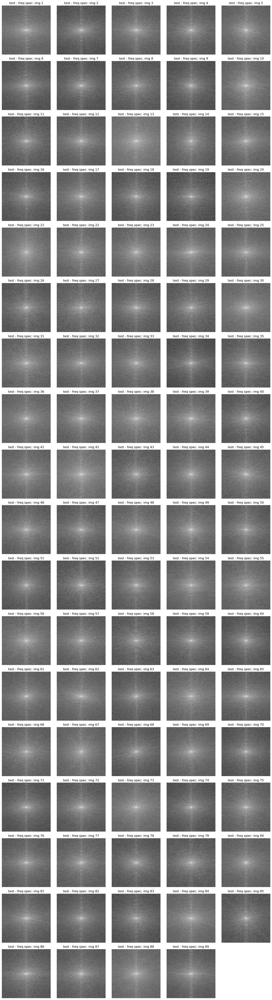

In [23]:
# Plotar todos os espectros de teste
plot_specs(normal_test_specs, title="test")

In [24]:
#pausa de teste

In [25]:
# Plotar todos os espectros de treino com ruído
#plot_specs(hacked_train_specs, title="train *")

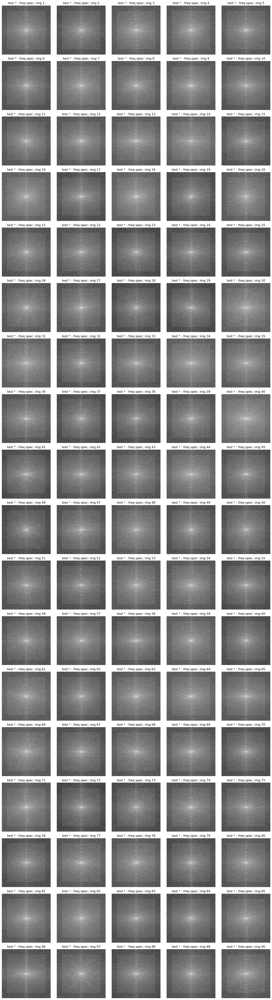

In [26]:
# Plotar todos os espectros de teste com ruído
plot_specs(hacked_test_specs, title="test *")

In [27]:
# Labels:
normal_train_labels = np.zeros(len(normal_train_specs), dtype=bool)
hacked_train_labels = np.ones(len(hacked_train_specs), dtype=bool)

normal_test_labels = np.zeros(len(normal_test_specs), dtype=bool)
hacked_test_labels = np.ones(len(hacked_test_specs), dtype=bool)

# Combina os espectros
all_train_specs = np.concatenate((normal_train_specs, hacked_train_specs), axis=0)
all_train_labels = np.concatenate((normal_train_labels, hacked_train_labels))

all_test_specs = np.concatenate((normal_test_specs, hacked_test_specs), axis=0)
all_test_labels = np.concatenate((normal_test_labels, hacked_test_labels))

print("Tamanho do conjunto de treino:", all_train_specs.shape)
print("Tamanho do conjunto de teste:", all_test_specs.shape)
print("Exemplo dos labels de treino (False = original, True = com ruído):", all_train_labels)

Tamanho do conjunto de treino: (1620, 224, 224)
Tamanho do conjunto de teste: (179, 224, 224)
Exemplo dos labels de treino (False = original, True = com ruído): [False False False ...  True  True  True]


In [28]:
#pausa de teste

In [29]:
# Pré-processamento dos dados: adiciona dimensão do canal
all_train_specs = np.expand_dims(all_train_specs, axis=-1)
all_test_specs = np.expand_dims(all_test_specs, axis=-1)

# Converte os labels para o formato one-hot
all_train_labels_cat = to_categorical(all_train_labels.astype(int), num_classes=2)
all_test_labels_cat = to_categorical(all_test_labels.astype(int), num_classes=2)

In [30]:
# Defines the model layers (now for ResNet50)
def model_resnet50():  # (Optional: Rename the function for clarity)
    # Camada de entrada para imagens em escala de cinza (mantido igual)
    inputs = Input(shape=(224, 224, 1))
    
    # 1. Conversão para 3 canais (mantido igual)
    x = Lambda(lambda x: tf.repeat(x, 3, axis=-1))(inputs)
    
    # 2. Pré-processamento ResNet (mantido igual)
    x = tf.keras.applications.resnet.preprocess_input(x)
    
    # 3. *** ALTERAÇÃO PRINCIPAL: Carregar ResNet-50 ***
    base_model = tf.keras.applications.ResNet50(
        weights='imagenet',
        include_top=False,
        input_tensor=x
    )
    
    # 4. Topo personalizado (mantido igual)
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    
    x = Dense(150, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    x = Dense(100, kernel_regularizer=regularizers.l2(0.01), activation='relu')(x)
    x = Dropout(0.25)(x)
    
    outputs = Dense(2, activation='softmax')(x)
    
    # Compilação (mantido igual)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(
        optimizer='Adam',
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

In [31]:
# Create model
model = model_resnet50()

I0000 00:00:1741794649.648735    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794649.648907    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794649.648961    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794649.983979    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1741794649.984382    4787 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:10:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-03-12

In [32]:
# Print the model summary
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 224, 224,  │          0 │ input_layer[0][0] │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item (GetItem)  │ (None, 224, 224)  │          0 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_1          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_2          │ (None, 224, 224)  │          0 │ lambda[0][0]      │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack (Stack)       │ (None, 224, 224,  │          0 │ get_item[0][0],   │
│                     │ 3)                │            │ get_item_1[0][0], │
│                     │                   │            │ get_item_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 224, 224,  │          0 │ stack[0][0]       │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 230, 230,  │          0 │ add[0][0]         │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 56, 56,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,928 │ conv2_block1_1_r

 Total params: 23,910,364 (91.21 MB)

 Trainable params: 23,857,244 (91.01 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [33]:
# Defines local to save the model results
output_folder = 'Models_saves'
base_name = 'model_' + nome
type = 'keras'

model_filepath = os.path.join(output_folder, get_next_filename(output_folder, base_name, type))
checkpoint = ModelCheckpoint(filepath=model_filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [34]:
start_time = time.time()

In [35]:
# Train the model
history = model.fit(
    all_train_specs, all_train_labels_cat,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=(all_test_specs, all_test_labels_cat),
    steps_per_epoch=len(all_train_specs) // BATCH_SIZE,
    callbacks=[checkpoint],
    verbose=1
)

Epoch 1/100


I0000 00:00:1741794681.474136    4855 service.cc:146] XLA service 0x7efc20002110 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1741794681.474215    4855 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3060, Compute Capability 8.6
2025-03-12 12:51:22.677662: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-03-12 12:51:25.675906: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 90101
2025-03-12 12:51:30.033637: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_15567', 196 bytes spill stores, 196 bytes spill loads

I0000 00:00:1741794726.326273    4855 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step - accuracy: 0.9067 - loss: 3.4000

2025-03-12 12:52:19.551596: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_1760', 208 bytes spill stores, 208 bytes spill loads




Epoch 1: val_accuracy improved from -inf to 0.49721, saving model to Models_saves/model_Yildirim_13.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 86s 362ms/step - accuracy: 0.9080 - loss: 3.3830 - val_accuracy: 0.4972 - val_loss: 890.3141
Epoch 2/100


2025-03-12 12:52:32.293265: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:393] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_15567', 208 bytes spill stores, 208 bytes spill loads



 1/50 ━━━━━━━━━━━━━━━━━━━━ 24:25 30s/step - accuracy: 1.0000 - loss: 1.2271

2025-03-12 12:52:54.457716: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
2025-03-12 12:52:54.458916: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]
/home/user/miniconda3/envs/tf_gpu/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)



Epoch 2: val_accuracy did not improve from 0.49721
50/50 ━━━━━━━━━━━━━━━━━━━━ 31s 17ms/step - accuracy: 1.0000 - loss: 1.2271 - val_accuracy: 0.4972 - val_loss: 1247.6946
Epoch 3/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step - accuracy: 1.0000 - loss: 0.9092
Epoch 3: val_accuracy improved from 0.49721 to 0.56983, saving model to Models_saves/model_Yildirim_13.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 18s 365ms/step - accuracy: 1.0000 - loss: 0.9050 - val_accuracy: 0.5698 - val_loss: 10.6525
Epoch 4/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 15s 321ms/step - accuracy: 1.0000 - loss: 0.3673

2025-03-12 12:53:13.694073: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 4: val_accuracy did not improve from 0.56983
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 1.0000 - loss: 0.3673 - val_accuracy: 0.5698 - val_loss: 9.6669
Epoch 5/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step - accuracy: 1.0000 - loss: 0.2863
Epoch 5: val_accuracy improved from 0.56983 to 0.81006, saving model to Models_saves/model_Yildirim_13.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 12s 248ms/step - accuracy: 1.0000 - loss: 0.2852 - val_accuracy: 0.8101 - val_loss: 0.5805
Epoch 6/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 16s 333ms/step - accuracy: 1.0000 - loss: 0.1358
Epoch 6: val_accuracy did not improve from 0.81006
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 1.0000 - loss: 0.1358 - val_accuracy: 0.7765 - val_loss: 0.5945
Epoch 7/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - accuracy: 1.0000 - loss: 0.1098
Epoch 7: val_accuracy improved from 0.81006 to 0.98883, saving model to Models_saves/model_Yildirim_13.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 20s 402ms/step - accuracy: 1.0000 - loss: 

2025-03-12 12:53:47.126670: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 8: val_accuracy did not improve from 0.98883
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 1.0000 - loss: 0.0586 - val_accuracy: 0.9832 - val_loss: 0.3448
Epoch 9/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - accuracy: 1.0000 - loss: 0.0493
Epoch 9: val_accuracy improved from 0.98883 to 1.00000, saving model to Models_saves/model_Yildirim_13.keras
50/50 ━━━━━━━━━━━━━━━━━━━━ 12s 236ms/step - accuracy: 1.0000 - loss: 0.0492 - val_accuracy: 1.0000 - val_loss: 0.2309
Epoch 10/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 13s 285ms/step - accuracy: 1.0000 - loss: 0.0304
Epoch 10: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 1.0000 - loss: 0.0304 - val_accuracy: 1.0000 - val_loss: 0.2420
Epoch 11/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step - accuracy: 1.0000 - loss: 0.0252
Epoch 11: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 8s 162ms/step - accuracy: 1.0000 - loss: 0.0252 - val_accuracy: 1.0000 - val_loss: 0.1013
Epoch 

2025-03-12 12:54:28.104557: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 16: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 1.0000 - loss: 0.0096 - val_accuracy: 1.0000 - val_loss: 0.0120
Epoch 17/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step - accuracy: 1.0000 - loss: 0.0072
Epoch 17: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 8s 165ms/step - accuracy: 1.0000 - loss: 0.0072 - val_accuracy: 1.0000 - val_loss: 0.0075
Epoch 18/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 111ms/step - accuracy: 1.0000 - loss: 0.0065
Epoch 18: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.0065 - val_accuracy: 1.0000 - val_loss: 0.0083
Epoch 19/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step - accuracy: 1.0000 - loss: 0.0064
Epoch 19: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 8s 163ms/step - accuracy: 1.0000 - loss: 0.0064 - val_accuracy: 1.0000 - val_loss: 0.0047
Epoch 20/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 112ms/step - accurac

2025-03-12 12:55:42.656727: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 32: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.0030 - val_accuracy: 1.0000 - val_loss: 0.0027
Epoch 33/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step - accuracy: 1.0000 - loss: 0.0030
Epoch 33: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 8s 163ms/step - accuracy: 1.0000 - loss: 0.0030 - val_accuracy: 1.0000 - val_loss: 0.0025
Epoch 34/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 111ms/step - accuracy: 1.0000 - loss: 0.0030
Epoch 34: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.0030 - val_accuracy: 1.0000 - val_loss: 0.0026
Epoch 35/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - accuracy: 1.0000 - loss: 0.0030
Epoch 35: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 11s 225ms/step - accuracy: 1.0000 - loss: 0.0030 - val_accuracy: 1.0000 - val_loss: 0.0025
Epoch 36/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accura

2025-03-12 12:58:11.849809: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[IteratorGetNext/_2]]



Epoch 64: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 1.0000 - loss: 0.0259 - val_accuracy: 0.5698 - val_loss: 0.9188
Epoch 65/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - accuracy: 0.9944 - loss: 0.0537
Epoch 65: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 11s 225ms/step - accuracy: 0.9945 - loss: 0.0535 - val_accuracy: 0.8603 - val_loss: 0.3783
Epoch 66/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 114ms/step - accuracy: 1.0000 - loss: 0.0232
Epoch 66: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 1.0000 - loss: 0.0232 - val_accuracy: 0.8436 - val_loss: 0.3963
Epoch 67/100
50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step - accuracy: 0.9889 - loss: 0.0524
Epoch 67: val_accuracy did not improve from 1.00000
50/50 ━━━━━━━━━━━━━━━━━━━━ 8s 163ms/step - accuracy: 0.9889 - loss: 0.0523 - val_accuracy: 1.0000 - val_loss: 0.0466
Epoch 68/100
 1/50 ━━━━━━━━━━━━━━━━━━━━ 5s 110ms/step - accura

In [36]:
end_time = time.time()

In [37]:
training_time = end_time - start_time

print(f"O modelo demorou {training_time:.2f} segundos para treinar.")

O modelo demorou 604.75 segundos para treinar.


In [38]:
# Make predictions
predictions = model.predict(all_test_specs)
y_pred = np.argmax(predictions, axis=1)
y_true = np.argmax(all_test_labels_cat, axis=1)

6/6 ━━━━━━━━━━━━━━━━━━━━ 6s 625ms/step


In [39]:
output_folder = 'Convergence_graphs'
type = 'png'

# Define the function to plot and save Convergence Graphs
def plot_and_save_graph(history):
    base_name = 'Graph_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path_png = os.path.join(output_folder, output_filename)
    
    output_base_name = output_filename.replace('.png', '')
    output_txt = os.path.join(output_folder, f'{output_base_name}.txt')

    fig, ax = plt.subplots(figsize=(6, 6))
    ax.plot(history.history['accuracy'])
    ax.plot(history.history['val_accuracy'])
    ax.set_title('Model accuracy')
    ax.set_ylabel('accuracy')
    ax.set_xlabel('epoch')
    ax.legend(['train', 'val'], loc='upper left')

    plt.savefig(output_path_png)

    plt.show()

    with open(output_txt, 'w') as f:
        f.write('Accuracy:\n')
        f.write(', '.join(map(str, history.history['accuracy'])) + '\n\n')
        f.write('Validation Accuracy:\n')
        f.write(', '.join(map(str, history.history['val_accuracy'])) + '\n')

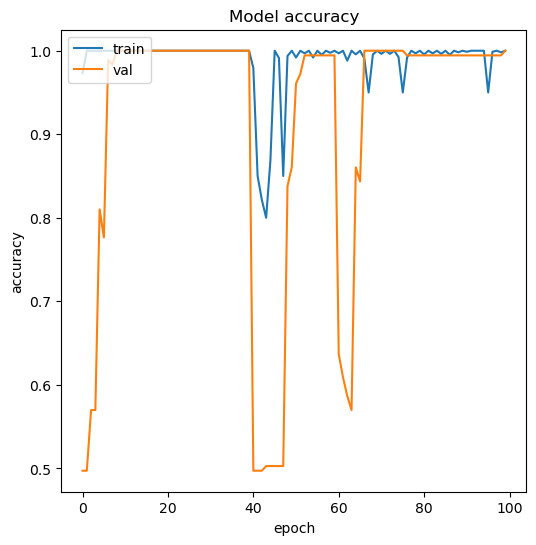

In [40]:
plot_and_save_graph(history)

In [41]:
cm_plot_labels = ['Normal', 'Hacked']

In [42]:
output_folder = 'Classification_report'
type = 'txt'

# Define the function to plot and save classification report
def plot_and_save_report(y_true, y_pred):
    base_name = 'report_' + nome

    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    report = classification_report(y_true, y_pred, target_names=cm_plot_labels)
    print(report)

    with open(output_path, 'w') as f:
        f.write(report)

In [43]:
plot_and_save_report(y_true, y_pred)

              precision    recall  f1-score   support

      Normal       1.00      1.00      1.00        89
      Hacked       1.00      1.00      1.00        90

    accuracy                           1.00       179
   macro avg       1.00      1.00      1.00       179
weighted avg       1.00      1.00      1.00       179



In [44]:
output_folder = 'Confusion_matrix'
type = 'png'

# Define the flot confusion matrix
def plot_and_matrix(y_true, y_pred, cm_plot_labels):
    base_name = 'matrix_' + nome
    
    output_filename = get_next_filename(output_folder, base_name, type)
    output_path = os.path.join(output_folder, output_filename)

    cm = confusion_matrix(y_true=y_true, y_pred=y_pred)

    plt.figure(figsize=(6,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.xticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    plt.yticks(ticks=[0.5, 1.5], labels=cm_plot_labels)
    
    plt.savefig(output_path)

    plt.show()

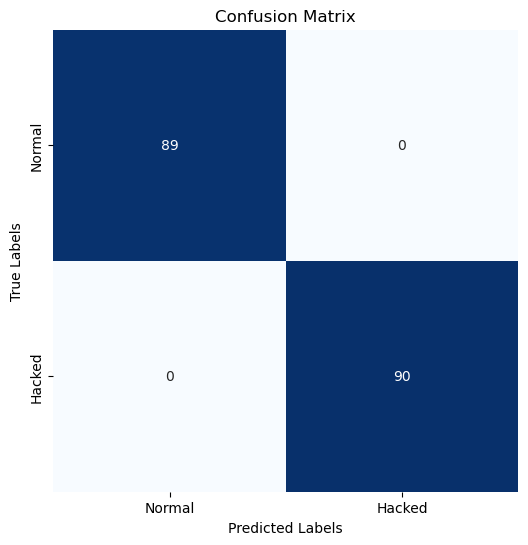

In [45]:
plot_and_matrix(y_true, y_pred, cm_plot_labels)

In [46]:
def plot_preds(X_test, y_true, y_pred):
    total_images = len(X_test)
    images_per_figure = 100
    cols = 5
    rows = (images_per_figure + cols - 1) // cols
    font_style = {'fontsize': 12, 'fontweight': 'bold'}

    for start in range(0, total_images, images_per_figure):
        plt.figure(figsize=(cols * 3, rows * 3))
        end = min(start + images_per_figure, total_images)

        for i in range(start, end):
            actual = 'Normal' if y_true[i] == 0 else 'Hacked'

            plt.subplot(rows, cols, i - start + 1)
            plt.title(f"Predict: {y_pred[i]} - {predictions[i][y_pred[i]] * 100:.2f}%\nActual: {y_true[i]} ({actual})", fontdict=font_style, color=('green' if y_pred[i] == y_true[i] else 'red'))
            plt.imshow(X_test[i], cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()

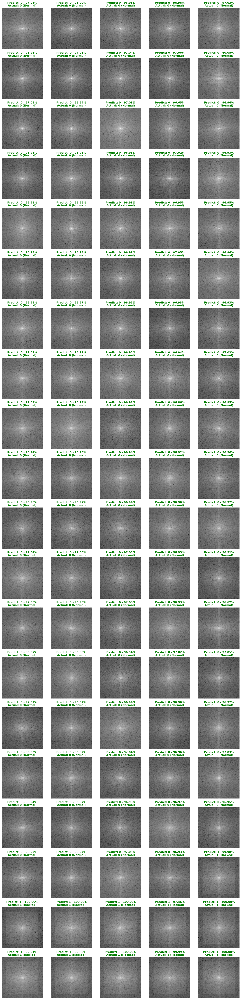

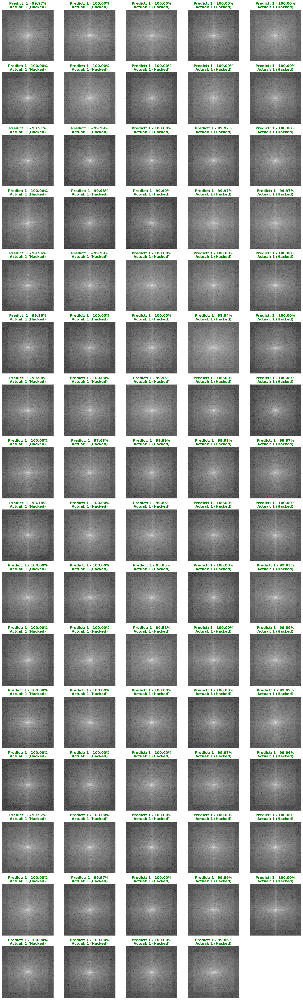

In [47]:
plot_preds(all_test_specs, y_true, y_pred)

In [48]:
# GC collect
gc.collect()

430140